<a href="https://www.kaggle.com/code/leonanvasconcelos/object-detection-with-pure-computer-vision?scriptVersionId=213427217" target="_blank"><img align="left" alt="Kaggle" title="Open in Kaggle" src="https://kaggle.com/static/images/open-in-kaggle.svg"></a>

<h1>Object Detection with Pure Computer Vision</h1>

Develop an automated system for detecting, counting, and analyzing round objects (such as fruits) using computer vision techniques. This system aims to enhance yield estimation, monitor crop health, and optimize harvesting processes by leveraging high-resolution images captured from any portable device like a mobile.
There is no need for GPU or any specially library like TensorFlow, Keras.
It uses only standard Python Libraries.

# 1. Requirements
## 1. Standard Libraries

In [1]:
from PIL import Image as PILImage
import os, random, io, base64, json
import numpy as np
import matplotlib.pyplot as plt

# Jupiter Notebook related
from IPython.display import display
!jupyter nbextension enable --py widgetsnbextension
!jupyter labextension enable @jupyter-widgets/jupyterlab-manager
import ipywidgets as widgets

Enabling notebook extension jupyter-js-widgets/extension...
      - Validating: OK


## 1.2. Author functions

All functions used by this notebook were created by Leonan Vasconcelos, available on GitHub below:

[https://github.com/LeonanUCM/ObjectDetectionPureCV.git](https://github.com/LeonanUCM/ObjectDetectionPureCV.git)

In [2]:
# Import functions created by the author available on GitHub

# Clone the repository only if it doesn't exist
import os, sys
if not os.path.exists('./ObjectDetectionPureCV'):
    !git clone https://github.com/LeonanUCM/ObjectDetectionPureCV.git

sys.path.append('./ObjectDetectionPureCV')

import config_profiles
import utils_cv

base_dir = r'ObjectDetectionPureCV/'
path_image = r"/kaggle/input/fruit-count/test_images/"

Cloning into 'ObjectDetectionPureCV'...
remote: Enumerating objects: 191, done.
remote: Counting objects: 100% (1/1), done.
remote: Total 191 (delta 0), reused 0 (delta 0), pack-reused 190 (from 1)
Receiving objects: 100% (191/191), 205.91 MiB | 18.92 MiB/s, done.
Resolving deltas: 100% (95/95), done.


# 2. Pre processing
## 2.1. Image Loading
   - **Data Collection:** Utilize drones, satellite imagery, or fixed cameras to capture high-resolution images of orchards, plantations, or fruit-bearing areas. Ensure consistent lighting conditions and optimal angles to facilitate accurate detection.
   - **Image Input Options:** Support both direct image file paths (`path_image`) and Base64-encoded image strings (`image64`) to provide flexibility in data sourcing..

/kaggle/working
Image loaded OK.


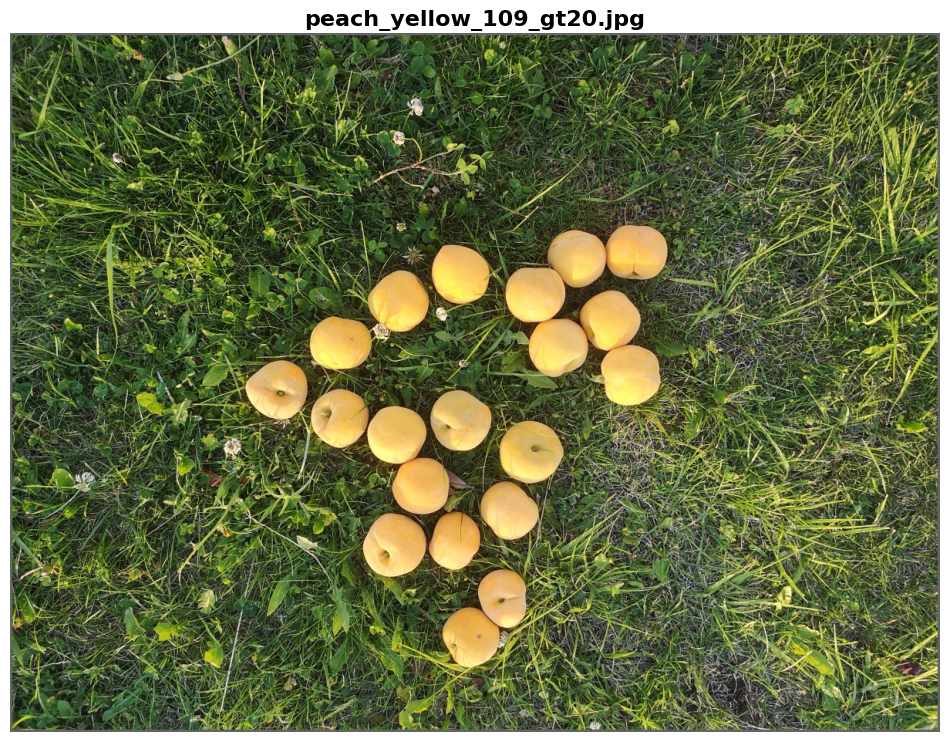

In [3]:
!pwd
file_name='peach_yellow_109_gt20.jpg'
profile='YELLOW_PEACH'

try:
    img_IO = PILImage.open(path_image + file_name)
    img_original = np.array(img_IO)
    print("Image loaded OK.")
except:
    error = '{"error": "Error reading file ' + path_image + '"}'
    print(error)
    raise error

utils_cv.show_mosaic([img_original], window_name=file_name)

## 2.2. EXIF Metadata Extraction

- 
Metadata extraction is a necessary step to gather the information required to prove the authenticity of the photo in a future legal proceeding.
The extracted metadata can also be used to map the locations where the photos were taken, ensuring that a sufficiently representative sample is collected.

In [4]:
result_exif = {}
if utils_cv.extract_metadata_EXIF(img_IO, result_exif):
    print(f"EXIF: coordinates={result_exif.get('coordinates')} \n      date={result_exif.get('capture_date')} \n      model={result_exif.get('mobile_model')}\n      manufacturer={result_exif.get('mobile_manufacturer')}")
img_IO.close()

EXIF: coordinates=(40.485344, -3.653178) 
      date=2024:06:04 20:37:45 
      model=CLT-L29
      manufacturer=HUAWEI


## 2.3. Configuration Loading
   - Loads color profiles and processing configurations based on the specified profile.
   - Ensures that the processing parameters are tailored to the specific color characteristics of the target object object
   - Profiles were generated before, using tunning methods.
   - The idea is to have a light sollution, with no need for large models like CNN, neither trainning with a large dataset...


In [5]:
cfg = config_profiles.load_config(profile)
print(cfg.as_text())



# Profile: YELLOW_PEACH
# Quality:
cfg.quantization_n_colors, cfg.max_resolution, cfg.smooth_colors, cfg.factor_contrast = (3, 1536, 19, 0.98)

# Blur:
cfg.blur_clahe_grid, cfg.blur_clahe_limit, cfg.blur_salt_pepper, cfg.blur_size = (5, 2.5, 5, 5)

# Amplify Saturation:
cfg.color_amplify_hue, cfg.color_amplify_range, cfg.color_amplify_increase = (40, 20, 0.5)

# Foreground selection:
cfg.foreground_list.append([['Background Green', -1], [70, 30, 20, 316, 100, 100, 3, 21, 11, 1]])
cfg.foreground_list.append([['Background Brown', -1], [0, 3, 8, 32, 39, 85, 1, 21, 11, 1]])
cfg.foreground_list.append([['Foreground Probably', 1], [33, 40, 37, 60, 100, 100, 27, 13, -31, 1]])
cfg.foreground_list.append([['Foreground Certainly', 2], [35, 60, 60, 50, 100, 100, 37, -7, -27, 3]])

# Texture Removal:
 cfg.texture_kernel_size, cfg.texture_threshold_value, cfg.texture_noise, cfg.texture_expand, cfg.texture_it = (29, 5, 1, 3, 1)

# Object Selection
cfg.mask_list.append([['Border', -1], [50, 0, 0, 1

## 2.4. Reduces computational cost

- Resizes the image to a maximum resolution to optimize processing speed without compromising essential detail.
>| Original Size | Reduced |
>|---------------|---------|
>|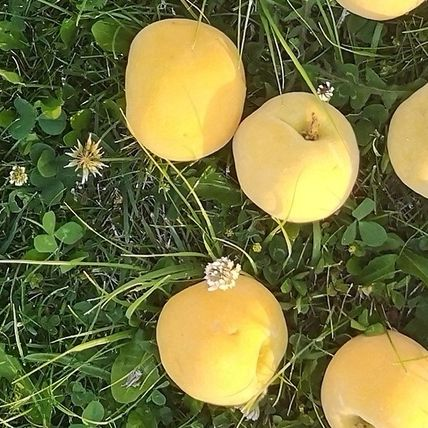| 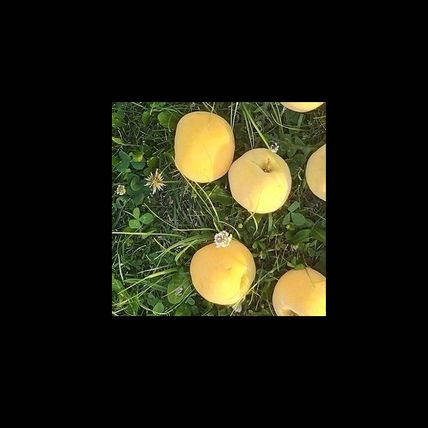 |

- Keeping aspect ratio is important to make sure objects keep its proportion when resized.
CNN models normally requires standard ratio (1:1) and size (640x640), which can be a bit flexible in some cases.
The problem when resizing is that it looses the aspect ratio. So a typical form of a fruit like orange (circle) may become a long ellipse, difficulting the detection.
The advantage of the method proposed on this work is to keep aspect ratio even for very wide cameras like the 9:22 of Samsung Z-flip.
>| Wide (9:22) | Squared (1:1) |
>|-------------|---------------|
>| 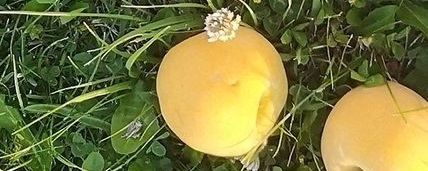 | 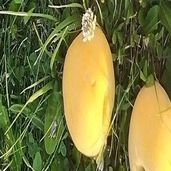 |

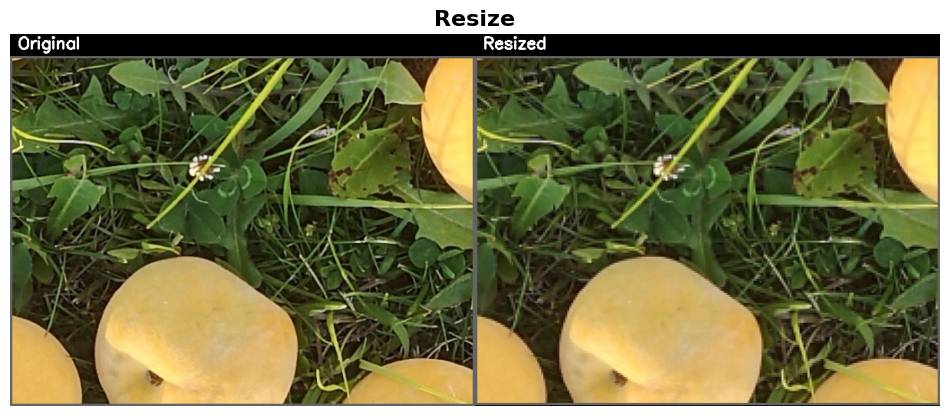

In [6]:
# Resize image to maximum resolution
img_reduced = utils_cv.resize_image(img_original, cfg.max_resolution)
utils_cv.show_mosaic([utils_cv.crop_center(img_original,0.15), utils_cv.crop_center(img_reduced,0.15)], 
                     headers=[f'Original', f'Resized'], window_name='Resize')

In [7]:
# Calculate the size
image_size_details = utils_cv.calculate_image_size(img_original)

# Print the results
print(image_size_details["explanation"])
print(f"Total size of original image: {image_size_details['total_size_mb']} MB")


image_size_details_reduced = utils_cv.calculate_image_size(img_reduced)
print(f"Total size of reduced image: {image_size_details_reduced['total_size_mb']} MB")
reduction = round((1 - image_size_details_reduced['total_size_bytes'] / image_size_details['total_size_bytes'])*100,2)

print(f"Difference: {reduction}% smaller")

The image array has dimensions (2736, 3648, 3).
Each element is of type 'uint8' and takes 1 bytes.
The total number of elements is 29942784, resulting in a total size of 29942784 bytes.
This equals approximately 28.56 MB.
Total size of original image: 28.56 MB
Total size of reduced image: 5.06 MB
Difference: 82.27% smaller


## 2.5. Color Amplification
- Enhances the saturation of specific hues to make target objects more distinguishable from the backgroun on images with little saturation<br>
- It may add some defects but will be smoothed later

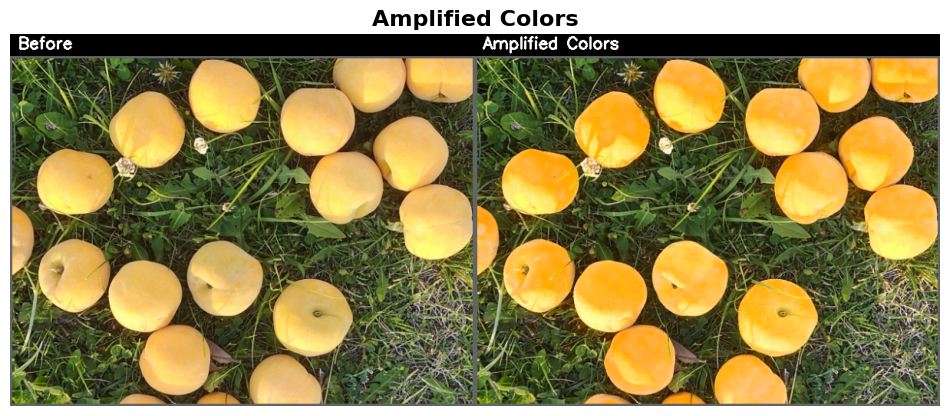

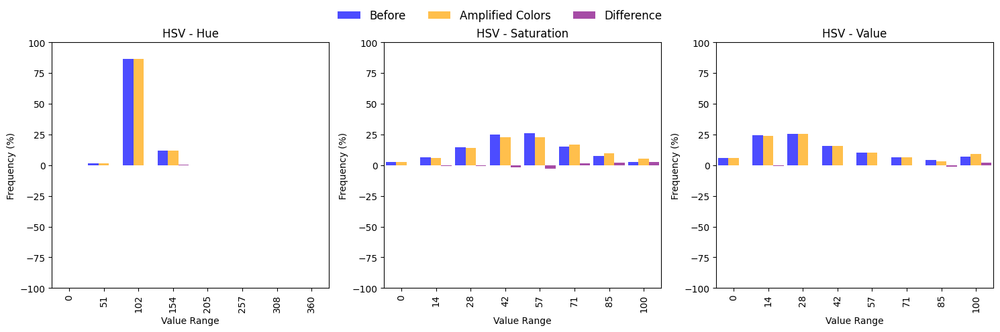

In [8]:
# Amplify saturation around a specific hue to enhance target objects

if cfg.color_amplify_range == 0:
    print('    Skipping Amplify Color')
    img_amplified = img_reduced
else:
    img_amplified = utils_cv.amplify_saturation_near_hue(img_reduced, cfg.color_amplify_hue, cfg.color_amplify_range, cfg.color_amplify_increase)
    
    utils_cv.show_mosaic([utils_cv.crop_center(img_reduced, 0.4), utils_cv.crop_center(img_amplified,0.4)],
                headers=['Before', 'Amplified Colors'],
                window_name=f'Amplified Colors')

    utils_cv.show_histograms(img_reduced, img_amplified, color_spaces=["HSV"], legend="Amplified Colors")


## 2.6. Color Smoothing
   - Applies color smoothing to reduce, including the ones created by last step.

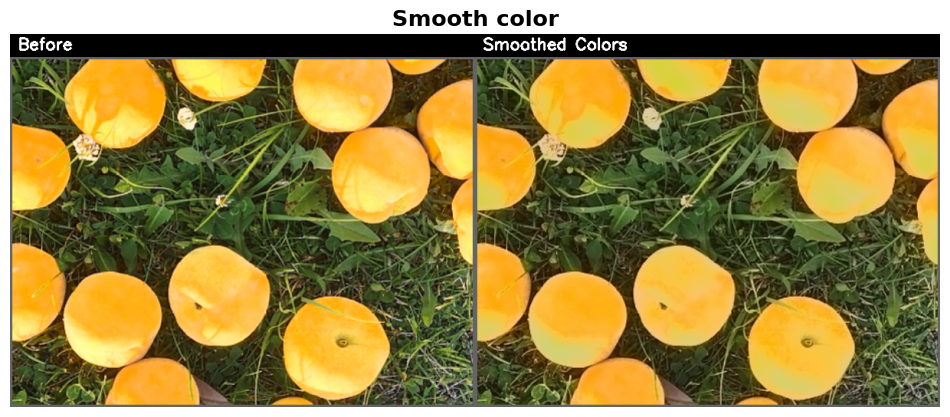

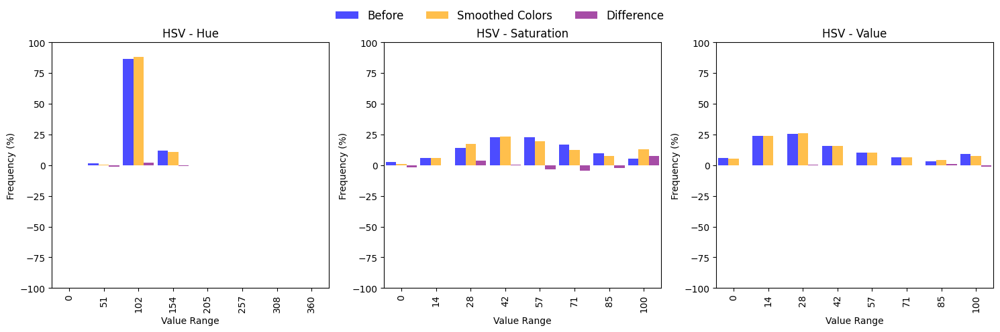

In [9]:
# Apply color smoothing if configured
if cfg.smooth_colors == 0:
    print('    Skipping Smooth Color')
    img_smooth_color = img_amplified
else:
    img_smooth_color = utils_cv.smooth_color(img_amplified, kernel_size=cfg.smooth_colors, min_brightness=20, max_brightness=210)

    utils_cv.show_mosaic([utils_cv.crop_center(img_amplified,0.3), utils_cv.crop_center(img_smooth_color,0.3)], 
                headers=['Before', 'Smoothed Colors'],
                window_name=f'Smooth color')
        

    utils_cv.show_histograms(img_amplified, img_smooth_color, color_spaces=["HSV"], legend="Smoothed Colors")

## 2.7. Removes Texturized Areas
- In the objects of our analysis, it can be clearly observed that the fruits studied,<br>
 in this case peaches, have a smooth peel without texture, unlike the background of the image,<br>
 which is the soil, usually sandy, or grass, both of which present a textured surface.
- This operation, even though simplified, removed more than 50% of the image, making the analysis much easier.

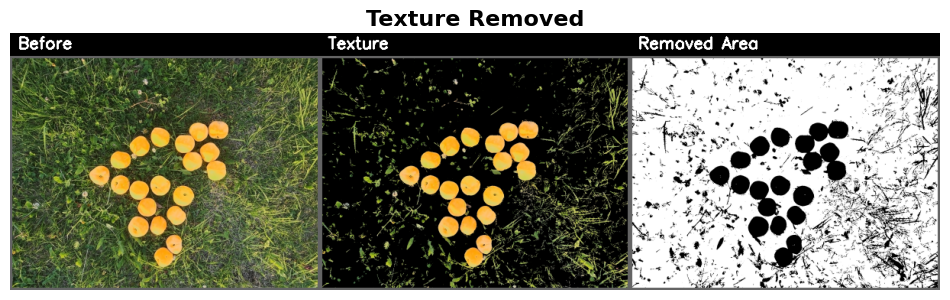

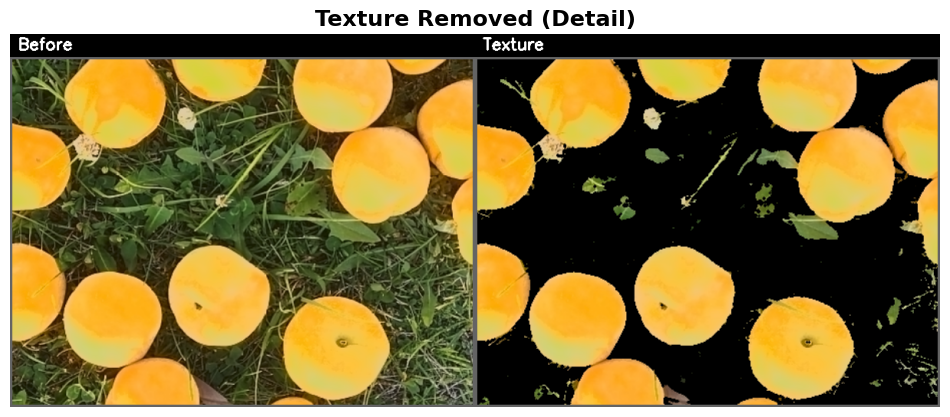

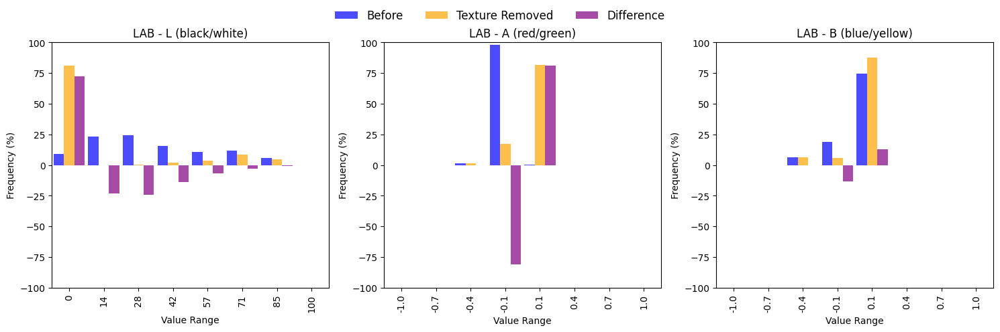

In [10]:
# Remove texture using morphological operations if configured
if cfg.texture_kernel_size <= 1:
    print('   Skipping Texture')
    img_texture = img_smooth_color
else:
    img_texture, mask = utils_cv.detect_smooth_areas_rgb(img_smooth_color, 
                                kernel_size=cfg.texture_kernel_size, 
                                threshold_value=cfg.texture_threshold_value, 
                                noise=cfg.texture_noise, 
                                expand=cfg.texture_expand, 
                                it=cfg.texture_it)
    
    utils_cv.show_mosaic([img_smooth_color, img_texture, ~mask],
                headers=['Before', 'Texture', 'Removed Area'],
                window_name=f'Texture Removed')

    utils_cv.show_mosaic([utils_cv.crop_center(img_smooth_color, 0.3), utils_cv.crop_center(img_texture, 0.3)],
                headers=['Before', 'Texture'],
                window_name=f'Texture Removed (Detail)')

    utils_cv.show_histograms(img_smooth_color, img_texture, color_spaces=["LAB"], legend="Texture Removed")


## 2.8. CLAHE
   - In this step, we applied Contrast Limited Adaptive Histogram Equalization (CLAHE) to better define the object and undesired noise.
   - Next, we removed the noise from the previous step.
   - Finally, we applied a Gaussian Blur to to further smooth the image.e.

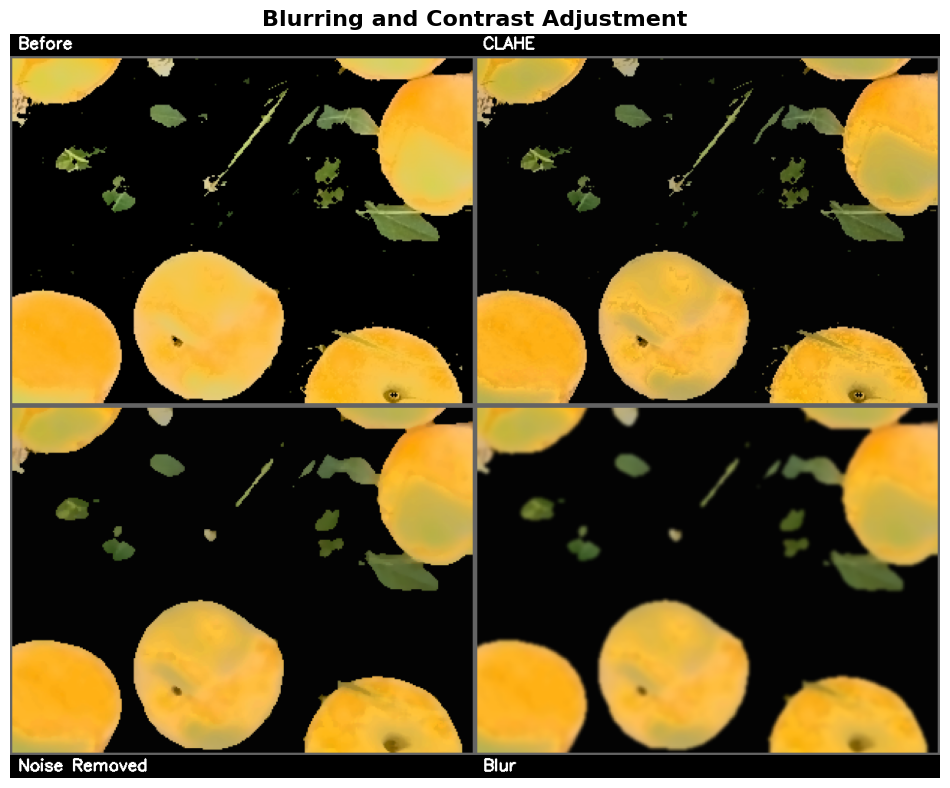

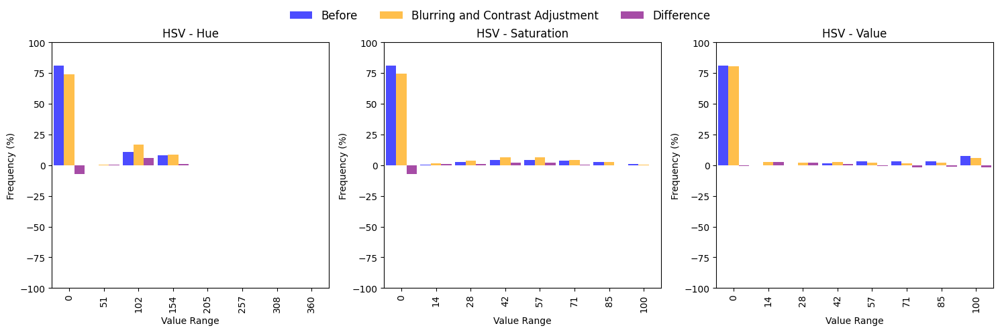

In [11]:
# Apply CLAHE, remove noise, and apply Gaussian blur
_, img_clahe, _ = utils_cv.apply_clahe(img_texture, 
                            tileGridSize=(cfg.blur_clahe_grid, cfg.blur_clahe_grid), 
                            clipLimit=cfg.blur_clahe_limit)
img_noise = utils_cv.remove_salt_and_pepper(img_clahe, kernel_size=cfg.blur_salt_pepper)
img_clahe_blur = utils_cv.blur_image(img_noise, kernel_size=cfg.blur_size)


utils_cv.show_mosaic([utils_cv.crop_center(img_texture,0.2), utils_cv.crop_center(img_clahe,0.2), utils_cv.crop_center(img_noise,0.2), utils_cv.crop_center(img_clahe_blur,0.2)],
            mosaic_dims=(2,2),
            headers=['Before', 'CLAHE'],
            footers=['Noise Removed', 'Blur'],
            window_name=f'Blurring and Contrast Adjustment')

utils_cv.show_histograms(img_texture, img_clahe_blur, color_spaces=["HSV"], legend="Blurring and Contrast Adjustment")

## 2.9. Foreground Selection
A system is implemented that combines weighted masks to select areas of the image with the highest probability of being a fruit.

1. Individual masks are generated for each color range in `foreground_list`.
2. Weighted masks are accumulated by summing pixel values across masks.
3. Pixels with positive accumulated values are selected as probable fruit areas, creating a final optimized mask.

<h3>Weight System and Masks</h3>
A mask is generated for each color range defined in `foreground_list`. Each mask is weighted based on its assigned value:
- **Negative values**: Indicate a high probability of being background (e.g., green).
- **Positive values**: Indicate a high probability of being the object (e.g., pure orange).

These masks are combined by summing the weighted values for each pixel, accumulating scores. Finally, only pixels with positive accumulated scores are selected, indicating a high probability of being a fruit.

<h3>Mask Adjustment and Refinement</h3>
Computer vision transformations are applied to refine the masks:
- **`noise` (`cv2.medianBlur`)**: Removes "salt and pepper" noise using a median filter.
- **`expand` (`cv2.dilate`)**: Expands white areas in the mask, filling gaps and connecting regions.
- **`close` (`cv2.morphologyEx` with `cv2.MORPH_CLOSE`)**: Closes small holes using a combination of dilation and erosion.
- **`iterations`**: Defines how many times `dilate` or `morphologyEx` are applied, controlling the level of refinement.

<h3>Handling Negative Parameters</h3>
When parameters like `close_kernel_size` or `expand_kernel_size` are negative:
- **Closing (`cv2.MORPH_CLOSE`) switches to Opening (`cv2.MORPH_OPEN`)**:
  - This helps separate nearby objects or remove small white areas in the mask.
- **Dilation (`cv2.dilate`) switches to Erosion (`cv2.erode`)**:
  - This shrinks white regions, making the mask more restrictive.

For example, when `close_kernel_size < 0`, the algorithm applies an **opening operation** (`cv2.morphologyEx` with `cv2.MORPH_OPEN`) to refine the mask.

<h3>Kernel Size Influence</h3>
The kernel size significantly affects the mask refinement:
- **Larger kernels**:
  - For dilation: Connect larger regions and fill bigger gaps.
  - For erosion: Remove larger regions and shrink masks significantly.
  - For closing/opening: Impact the size and number of areas affected.
- **Smaller kernels**:
  - Focus on finer details, affecting only small regions.

The choice of kernel size determines the granularity of the mask refinement and its ability to separate objects from the background.


<h3>Use of LAB Color Space</h3>
In complex cases, such as red/yellow peaches that exhibit a wide range of colors (pink, red, orange, yellow, and green), the **LAB** color space is more effective than HSV. The A and B channels allow better differentiation of magenta-green and yellow-blue tones.

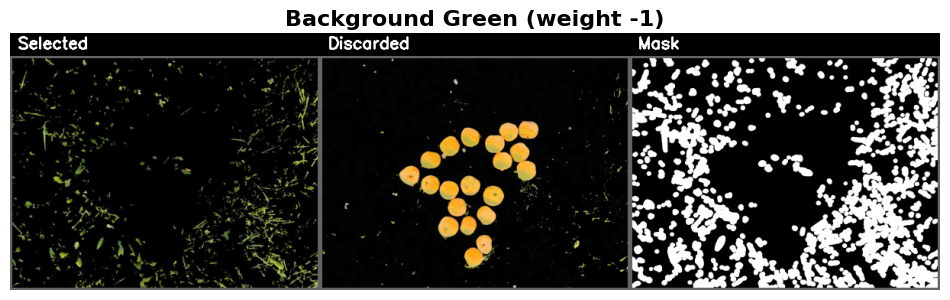

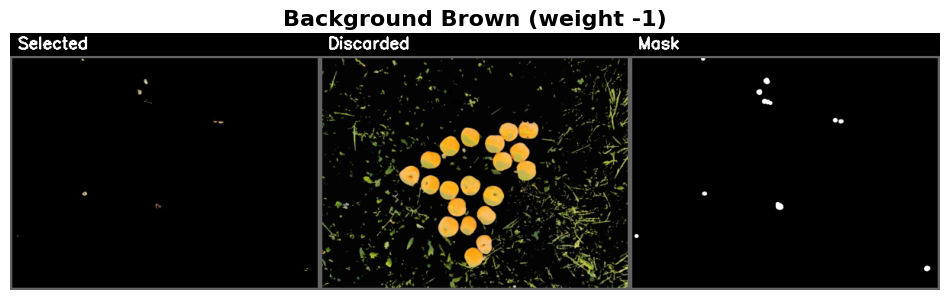

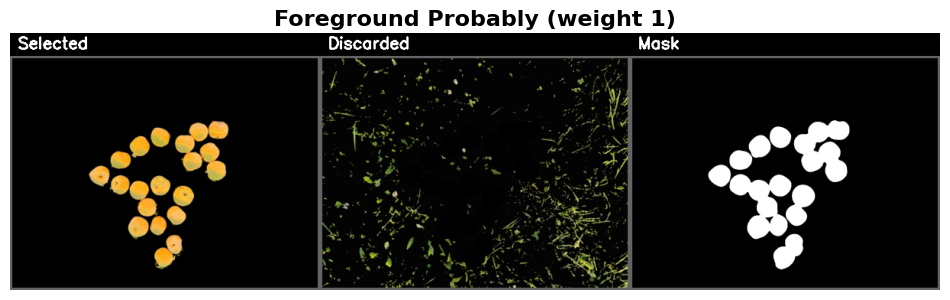

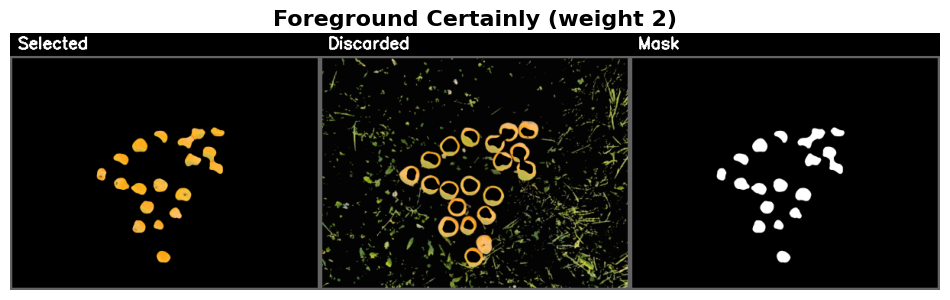

In [12]:
img_before = img_clahe_blur.copy()
img_tmp = img_before.copy()
mask_tmp = np.zeros(img_tmp.shape[:2], dtype=np.int8)

# Iterate through the list of foreground colors to create masks
for i in range(len(cfg.foreground_list)):
    cfg.foreground_name = cfg.foreground_list[i][0][0]
    cfg.foreground_weight = cfg.foreground_list[i][0][1]
    color_space = 'LAB' if 'LAB' in cfg.foreground_name else 'HSV'

    if cfg.foreground_weight != 0:
        selected_area, discarded_area, mask_selected = utils_cv.filter_color(img_tmp, 
                                                        color_ini=cfg.foreground_list[i][1][0:3], 
                                                        color_end=cfg.foreground_list[i][1][3:6],  
                                                        noise=cfg.foreground_list[i][1][6],
                                                        expand=cfg.foreground_list[i][1][7],
                                                        close=cfg.foreground_list[i][1][8],
                                                        iterations=cfg.foreground_list[i][1][9],
                                                        color_space=color_space)

        utils_cv.show_mosaic([selected_area, discarded_area, mask_selected], 
                    headers=['Selected', 'Discarded', 'Mask'],
                    window_name=f'{cfg.foreground_name} (weight {cfg.foreground_weight})')
        
        # Accumulate mask weights based on configuration
        mask_tmp += np.where(mask_selected > 0, cfg.foreground_weight, 0)

        del selected_area, discarded_area, mask_selected
    print('')

# Create a binary foreground mask
mask_foreground = np.where(mask_tmp >= 1, 255, 0).astype('uint8')
mask_foreground = utils_cv.expand_mask_circle(mask_foreground, kernel_size=7, iterations=1)

# Apply the foreground mask to the smoothed color image
img_foreground = utils_cv.select_mask(img_smooth_color, mask_foreground)
img_background = utils_cv.select_mask(img_smooth_color,~mask_foreground)

As brighter the mask is, more probably it is an object:


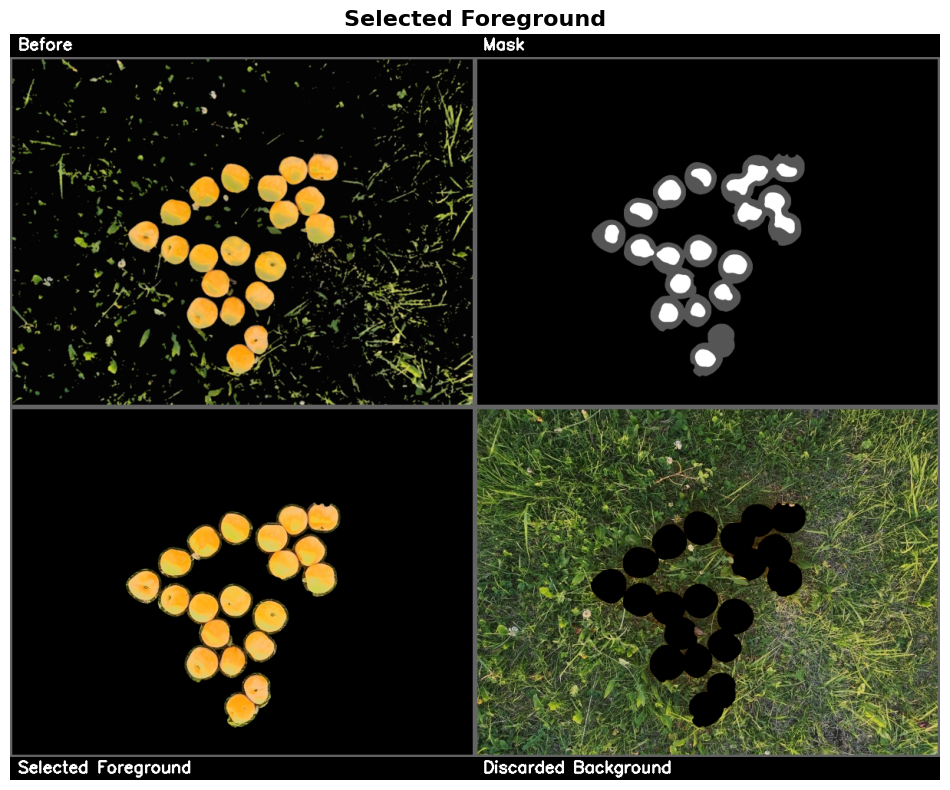

In [13]:
print("As brighter the mask is, more probably it is an object:")
mask_normal = utils_cv.weights_to_grayscale(mask_tmp)

utils_cv.show_mosaic([img_before, mask_normal, img_foreground, img_background],
                     mosaic_dims=(2,2),
                     headers=['Before', 'Mask'],
                     footers=['Selected Foreground', 'Discarded Background'],
                     window_name=f'Selected Foreground')

## 2.10. Clustering

In this section, color quantization is applied to simplify the color space by grouping similar colors into clusters using K-Means clustering. 
This step reduces noise and helps to isolate the fruit regions.

The image is simplified into three clusters using K-Means.

`cv2.kmeans(data, n_clusters, None, criteria, attempts, cv2.KMEANS_PP_CENTERS)`

- **data**: The pixel values of the image, reorganized into a one-dimensional array.
- **n_clusters**: The number of clusters (e.g., 3 for the fruit, the boundary, and the background).
- **criteria**: Termination criteria, such as maximum iterations or precision.
- **cv2.KMEANS_PP_CENTERS**: A method that initializes the cluster centers for better convergence, as fruits are usually located near the center of the image.

This process ensures precise isolation of the fruit while minimizing noise and excluding background areas.

The cluster corresponding to the fruit is identified based on its predominant color.

K-Means replaces the original pixel colors with arbitrary colors, in this case from the `cv2.COLORMAP_JET` palette.

- **Cluster 1**: Background area (brown).
- **Cluster 2**: Fruit boundary (dark blue).
- **Cluster 3**: The fruit itself (light green).

This color transformation causes the original fruit color (e.g., orange) to be lost, making it necessary to remap the cluster colors to meaningful labls for further processing.


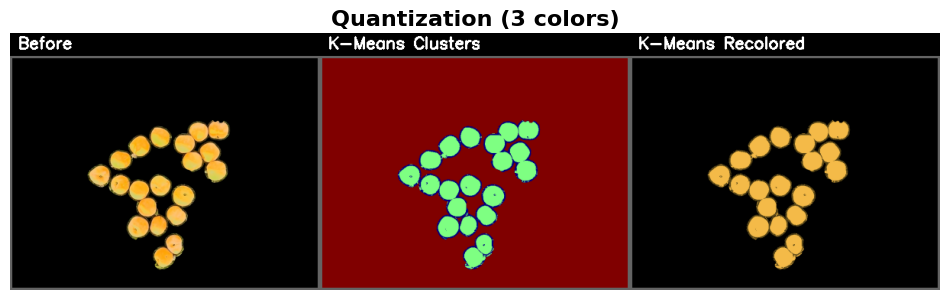

In [14]:
# Apply K-Means color quantization if configured
if cfg.quantization_n_colors == 0:
    print('    Skipping Quantization')
    img_clustered = img_foreground
else:
    # Perform color quantization
    img_clustered, clustered_rgb, clustered_labels = utils_cv.kmeans_recolor(img_foreground, n_clusters=cfg.quantization_n_colors)

    utils_cv.show_mosaic([img_foreground, clustered_rgb, img_clustered], 
                headers=['Before', 'K-Means Clusters', 'K-Means Recolored'], 
                window_name=f'Quantization ({cfg.quantization_n_colors} colors)')
            

## 2.11. Refinement

The refinement process is similar to the one applied in `2.10 Clustering`, using it as input or starting point. However, the parameters are adjusted to focus on separating closely connected objects.

### Purpose
In clustering, the objective was to group similar colors into clusters to isolate the fruit. In refinement, the goal shifts to ensuring that individual objects, even those that are close together or touching, are properly separated.

### Adjustments
The parameters for operations like mask dilation, erosion, or morphological transformations are fine-tuned to:

- Shrink or expand specific regions.
- Eliminate bridges or connections between closely packed objects.
- Retain the shape and boundaries of the detected fruits.

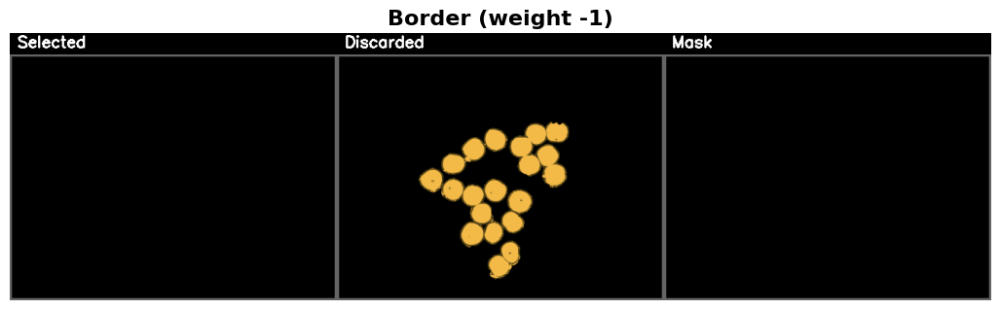

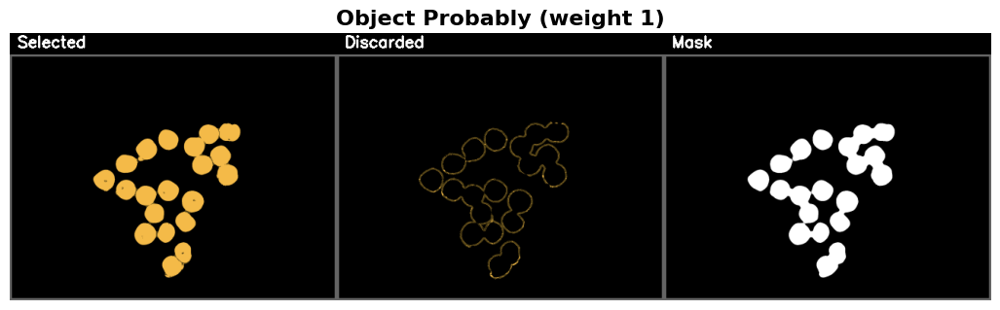

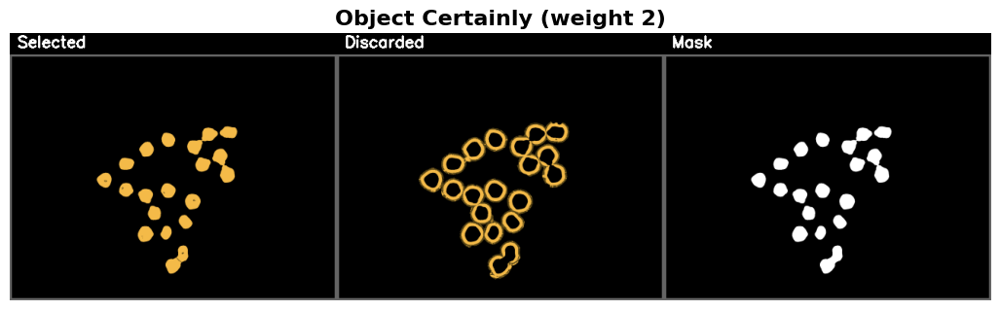

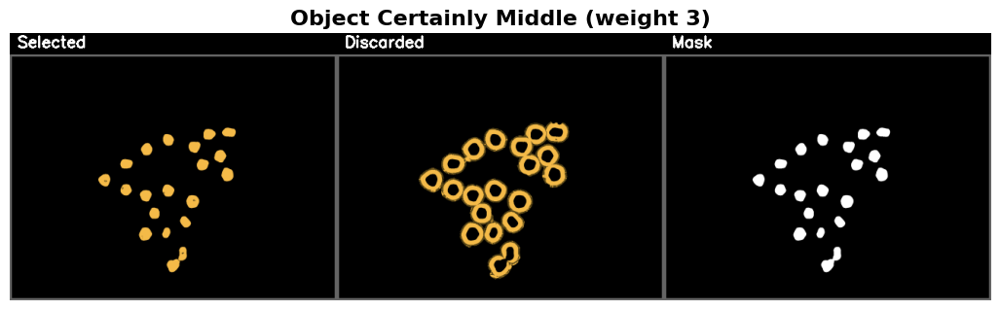

As brighter the mask is, more probably it is an object:


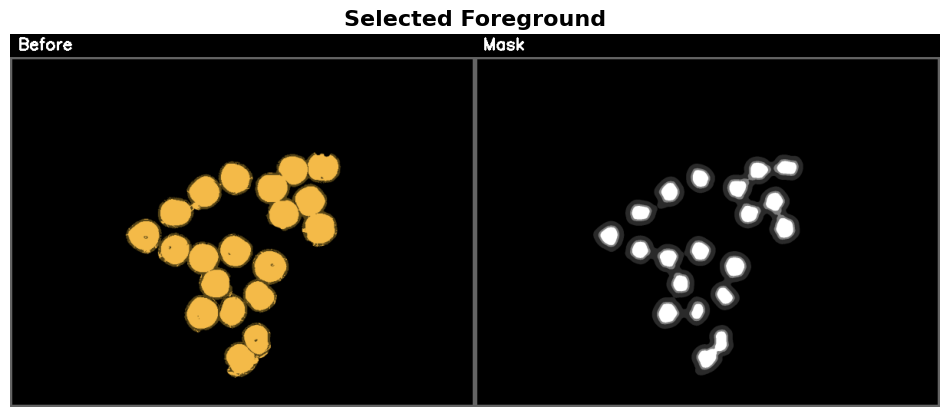

In [15]:
img_before = img_clustered
img_tmp = img_before
mask_tmp = np.zeros(img_tmp.shape[:2], dtype=np.int8)

# Iterate through the list of target colors to create masks for object detection
for i in range(len(cfg.mask_list)):
    cfg.color_name = cfg.mask_list[i][0][0]
    cfg.color_weight = cfg.mask_list[i][0][1]

    if cfg.color_weight != 0:
        selected_area, discarded_area, mask_selected = utils_cv.filter_color(img_tmp, 
                                                        color_ini=cfg.mask_list[i][1][0:3], 
                                                        color_end=cfg.mask_list[i][1][3:6],  
                                                        noise=cfg.mask_list[i][1][6],
                                                        expand=cfg.mask_list[i][1][7],
                                                        close=cfg.mask_list[i][1][8],
                                                        iterations=cfg.mask_list[i][1][9])
        
        utils_cv.show_mosaic([selected_area, discarded_area, mask_selected], 
                    headers=['Selected', 'Discarded', 'Mask'],
                    window_name=f'{cfg.color_name} (weight {cfg.color_weight})',
                    max_resolution=1300)
        
        # Accumulate mask weights based on configuration
        mask_tmp += np.where(mask_selected > 0, cfg.color_weight, 0)

        del selected_area, discarded_area, mask_selected


print("As brighter the mask is, more probably it is an object:")
mask_normal = utils_cv.weights_to_grayscale(mask_tmp)

utils_cv.show_mosaic([img_before, mask_normal],
                     headers=['Before', 'Mask'],
                     window_name=f'Selected Foreground')

## 2.12. Mask preparation

Adjust the mask in order to ease object detection based on circles.:

- Invert mask, because it is easier to find black objects in white background.
- Remove small imperfections with Blur.

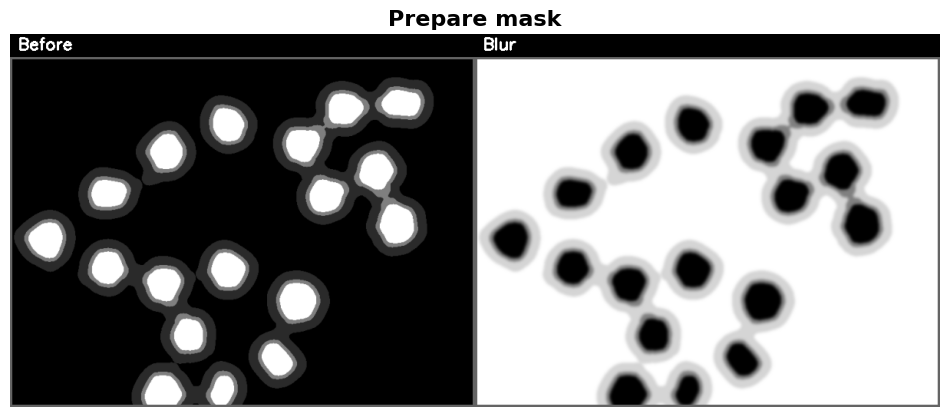

In [16]:
# Convert mask to grayscale and invert
mask_before = mask_normal
mask_tmp = ~mask_normal.copy()

# Apply noise removal and blurring to the mask
mask_blur = utils_cv.blur_image(mask_tmp, kernel_size=13)

utils_cv.show_mosaic([utils_cv.crop_center(mask_before,0.5), utils_cv.crop_center(mask_blur,0.5)], 
            window_name='Prepare mask', 
            headers=['Before', 'Blur'])

## Result of Preprocessing

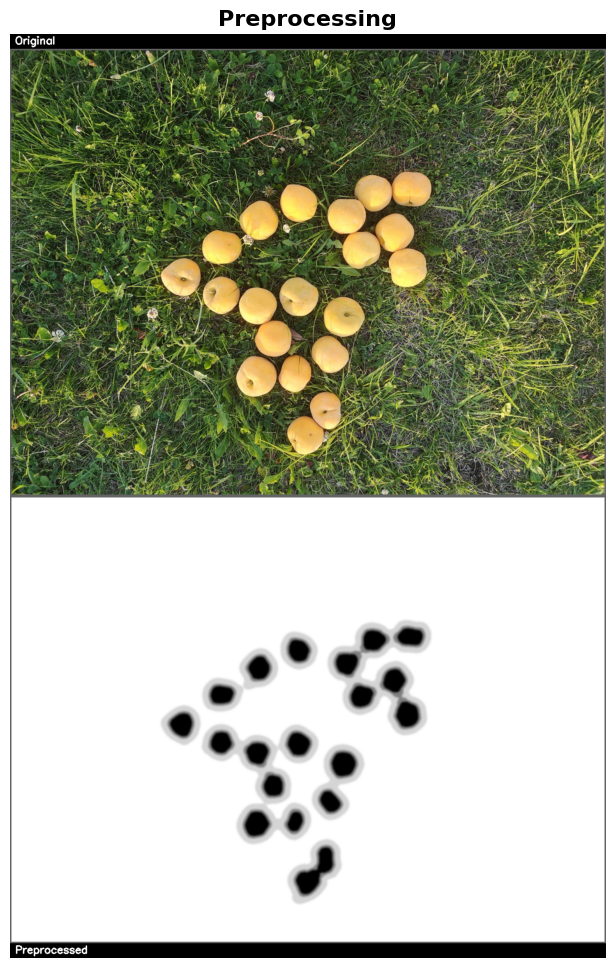

In [17]:
img_preprocessed = mask_blur
utils_cv.show_mosaic([img_reduced, img_preprocessed], 
            mosaic_dims=(2,1),
            headers=['Original'], 
            footers=['Preprocessed'], 
            window_name='Preprocessing')

# 3. Detect Objects

The `detect_circles` function is designed to identify circular shapes (or "blobs") in an image, such as round fruits. Detecting circles can be challenging due to variations in size, shape, lighting, and partial occlusions. This function takes an approach by performing multiple detection rounds (referred to as “turns”), each time relaxing the criteria for what is considered a circle. 

Initially, it searches for well-defined, larger circles, and with each subsequent turn, it becomes less strict, allowing the detection of smaller or more irregular shapes.

By progressively lowering the requirements, the function ensures a comprehensive search for circular objects that might not be perfectly shaped or fully visible.
However, this approach can produce overlapping detections, where multiple circles represent the same object. 
To address this, the function includes a post-processing step that removes overlaps, ensuring that each fruit is represented by a single, distinct circle.

Additionally, after each detection pass, the identified circles are removed from the analysis. 
By doing this, the subsequent turns focus only on remaining, undetected areas. 
As a result, this method reduces false positives and highlights new circles that might be hidden behind already detected ones.

    Turn 1: 14 circles detected.
    Turn 2: 17 circles detected.
    Turn 3: 5 circles detected.
    Turn 4: 2 circles detected.
    Turn 5: 1 circles detected.
    Remove overlaps: Number of circles before=39, after=20.


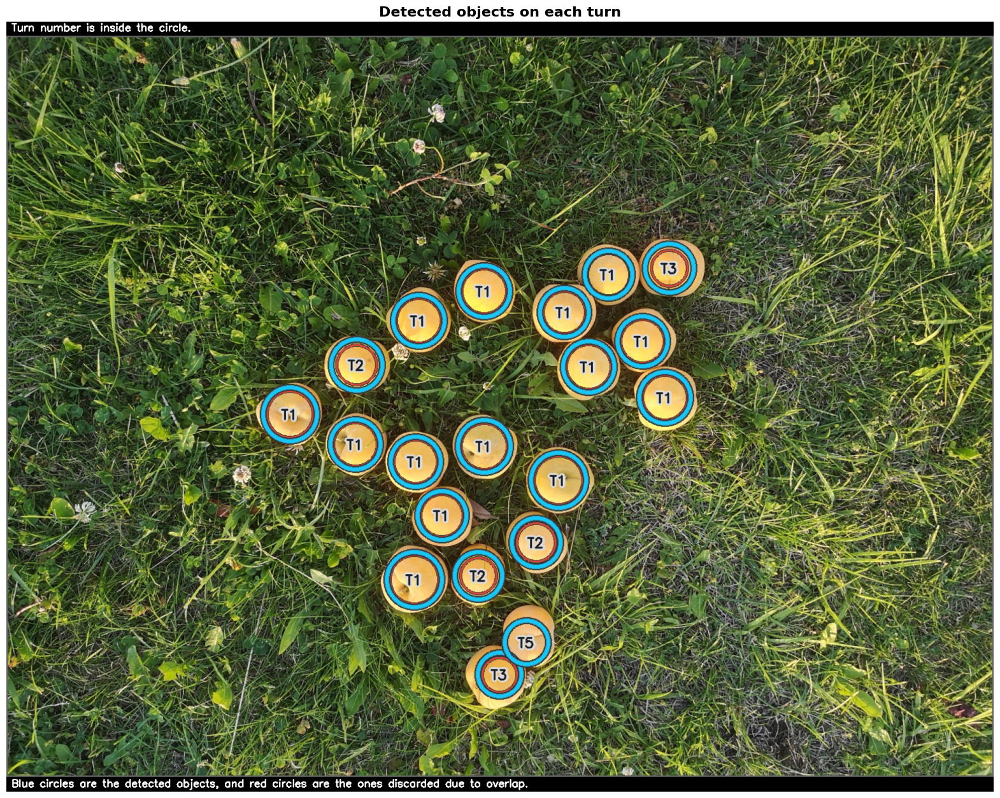

In [18]:
# Detect circles representing objects
circles, img_delimited, mask_circles = \
    utils_cv.detect_circles(img_preprocessed, img_original=img_reduced,
                    minCircularity=cfg.circle_minCircularity, 
                    minConvexity=cfg.circle_minConvexity, 
                    minInertiaRatio=cfg.circle_minInertiaRatio, 
                    minArea=cfg.circle_minArea, 
                    maxArea=cfg.circle_maxArea,
                    min_radius=cfg.min_radius_circle,
                    tolerance_overlap=cfg.tolerance_overlap)

num_found_objects = len(circles)

utils_cv.show_mosaic([img_delimited], 
            window_name='Detected objects on each turn', 
            headers=['Turn number is inside the circle.'],
            max_resolution=2000,
            footers=['Blue circles are the detected objects, and red circles are the ones discarded due to overlap.'])

# 4. Final Result

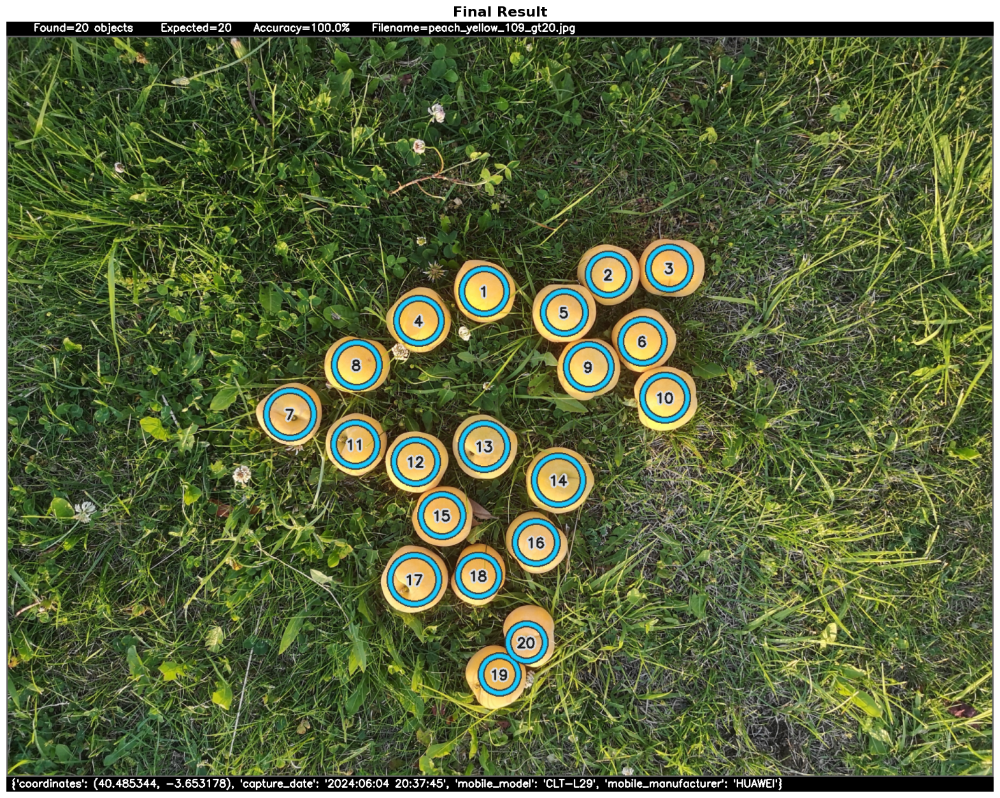

In [19]:
# Draw detected circles on the original smoothed color image
img_final = utils_cv.draw_circles(img_reduced, circles, show_label=True, solid=False)

try:
    # Extract expected number of objects from filename
    num_expected_objects = int(file_name[file_name.find("_gt") + 3:file_name.rfind(".")])
    accuracy = 100 * num_found_objects / num_expected_objects
    filename_result = f"{file_name}_result_pd=[{num_found_objects}]acc=[{accuracy:.1f}pct].jpg"
    header_image = f"    Found={num_found_objects} objects     Expected={num_expected_objects}    Accuracy={accuracy:.1f}%"
except:
    num_expected_objects = -1
    accuracy = -1
    filename_result = f"{file_name}_result.jpg"
    header_image = f"    Found={num_found_objects} objects"

header_image += f"    Filename={file_name}" if file_name != '' else ''
footer_image = f"{result_exif}"

utils_cv.show_mosaic([img_final], 
            headers=[header_image],
            footers=[footer_image],
            window_name='Final Result',
            max_resolution=2000)

# 5. Batch test

      

In [20]:
result_images = utils_cv.test_directory(f"{base_dir}/test_images", cfg)

Directory: ObjectDetectionPureCV//test_images


  0%|          | 0/10 [00:00<?, ?it/s]

File: peach_yellow_110_gt20.jpg




As brighter the mask is, more probably it is an object:
    Turn 1: 9 circles detected.
    Turn 2: 15 circles detected.
    Turn 3: 7 circles detected.
    Turn 4: 1 circles detected.


 10%|█         | 1/10 [00:02<00:22,  2.53s/it]

    Turn 5: 4 circles detected.
    Remove overlaps: Number of circles before=36, after=20.
File: peach_yellow_105_gt20.jpg




As brighter the mask is, more probably it is an object:
    Turn 1: 18 circles detected.
    Turn 2: 20 circles detected.
    Turn 3: 2 circles detected.
    Turn 4: 0 circles detected.


 20%|██        | 2/10 [00:05<00:19,  2.50s/it]

    Turn 5: 0 circles detected.
    Remove overlaps: Number of circles before=40, after=20.
File: peach_yellow_106_gt20.jpg




As brighter the mask is, more probably it is an object:
    Turn 1: 17 circles detected.
    Turn 2: 20 circles detected.
    Turn 3: 3 circles detected.
    Turn 4: 0 circles detected.


 30%|███       | 3/10 [00:07<00:17,  2.50s/it]

    Turn 5: 0 circles detected.
    Remove overlaps: Number of circles before=40, after=20.
File: peach_yellow_109_gt20.jpg




As brighter the mask is, more probably it is an object:
    Turn 1: 14 circles detected.
    Turn 2: 17 circles detected.
    Turn 3: 5 circles detected.
    Turn 4: 2 circles detected.


 40%|████      | 4/10 [00:10<00:15,  2.50s/it]

    Turn 5: 1 circles detected.
    Remove overlaps: Number of circles before=39, after=20.
File: peach_yellow_107_gt20.jpg




As brighter the mask is, more probably it is an object:
    Turn 1: 17 circles detected.
    Turn 2: 20 circles detected.
    Turn 3: 3 circles detected.
    Turn 4: 0 circles detected.
    Turn 5: 0 circles detected.


 50%|█████     | 5/10 [00:12<00:12,  2.47s/it]

    Remove overlaps: Number of circles before=40, after=20.
File: peach_yellow_103_gt20.jpg




As brighter the mask is, more probably it is an object:
    Turn 1: 16 circles detected.
    Turn 2: 20 circles detected.
    Turn 3: 4 circles detected.
    Turn 4: 0 circles detected.
    Turn 5: 0 circles detected.
    Remove overlaps: Number of circles before=40, after=20.


 60%|██████    | 6/10 [00:14<00:09,  2.46s/it]

File: peach_yellow_102_gt20.jpg




As brighter the mask is, more probably it is an object:
    Turn 1: 18 circles detected.
    Turn 2: 20 circles detected.
    Turn 3: 2 circles detected.
    Turn 4: 0 circles detected.
    Turn 5: 0 circles detected.
    Remove overlaps: Number of circles before=40, after=20.


 70%|███████   | 7/10 [00:17<00:07,  2.46s/it]

File: peach_yellow_101_gt20.jpg




As brighter the mask is, more probably it is an object:
    Turn 1: 17 circles detected.
    Turn 2: 20 circles detected.
    Turn 3: 3 circles detected.
    Turn 4: 0 circles detected.


 80%|████████  | 8/10 [00:19<00:04,  2.48s/it]

    Turn 5: 0 circles detected.
    Remove overlaps: Number of circles before=40, after=20.
File: peach_yellow_104_gt20.jpg




As brighter the mask is, more probably it is an object:
    Turn 1: 18 circles detected.
    Turn 2: 20 circles detected.
    Turn 3: 2 circles detected.
    Turn 4: 0 circles detected.
    Turn 5: 0 circles detected.


 90%|█████████ | 9/10 [00:22<00:02,  2.46s/it]

    Remove overlaps: Number of circles before=40, after=20.
File: peach_yellow_108_gt20.jpg




As brighter the mask is, more probably it is an object:
    Turn 1: 20 circles detected.
    Turn 2: 20 circles detected.
    Turn 3: 0 circles detected.
    Turn 4: 0 circles detected.
    Turn 5: 0 circles detected.


100%|██████████| 10/10 [00:24<00:00,  2.47s/it]

    Remove overlaps: Number of circles before=40, after=20.


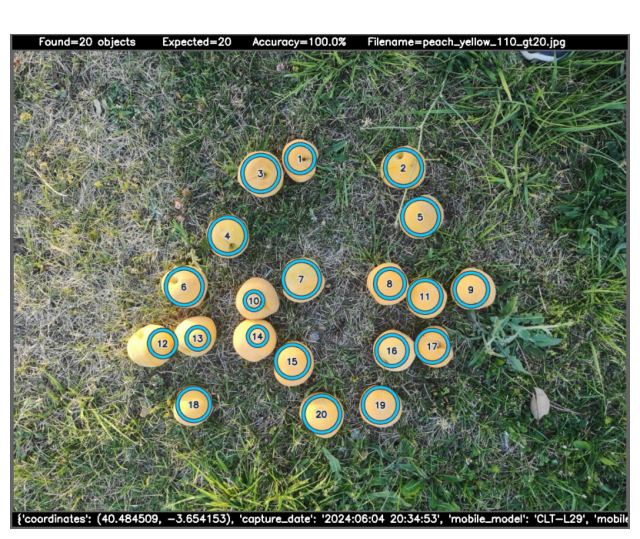

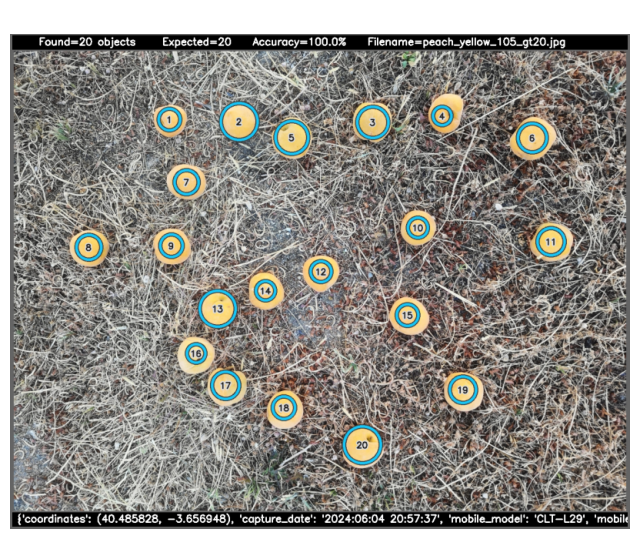

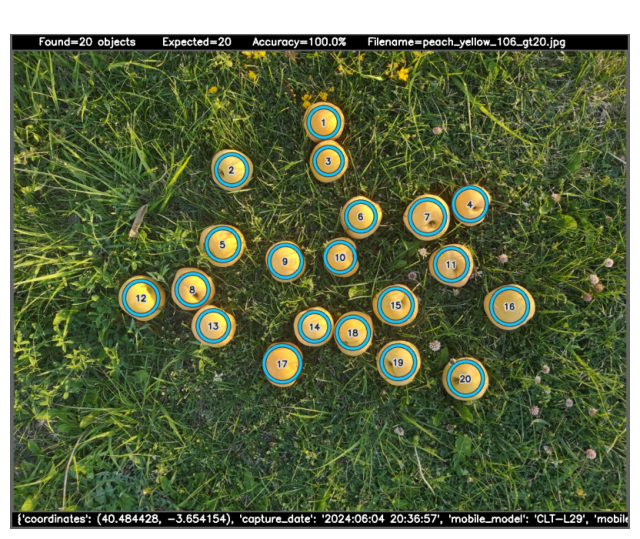

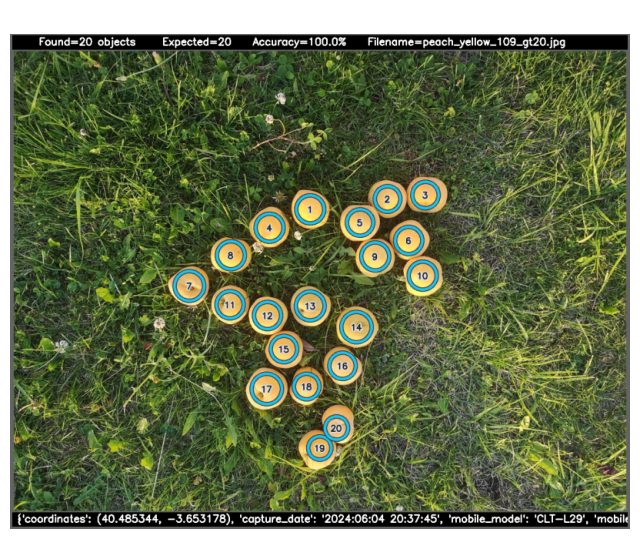

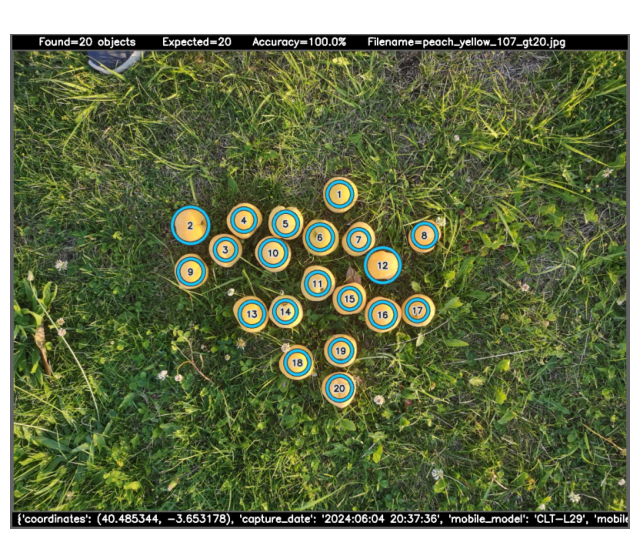

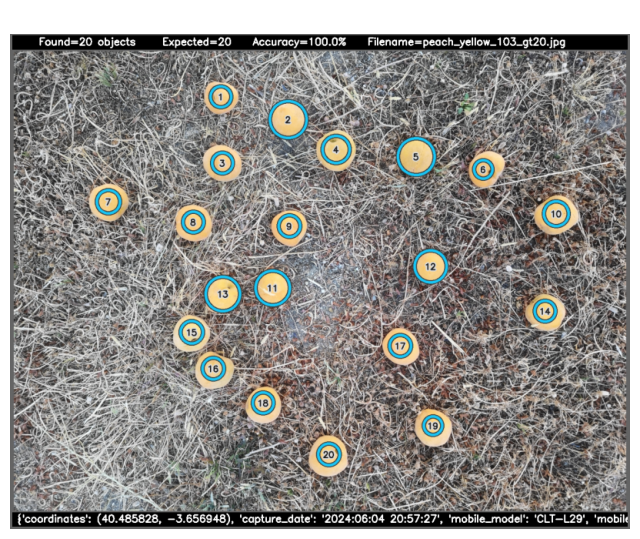

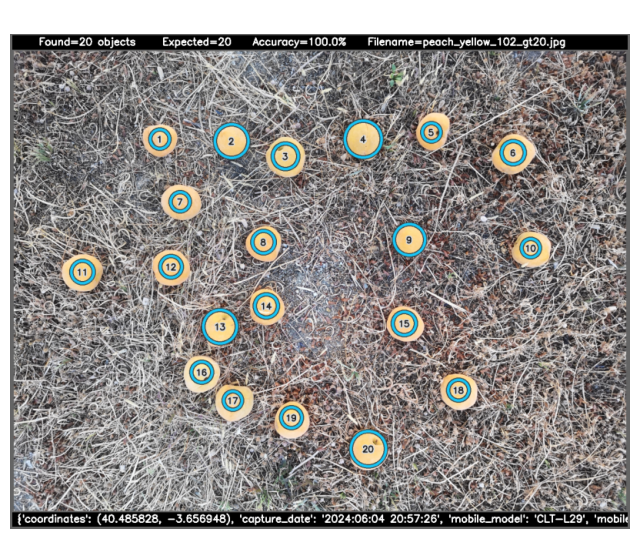

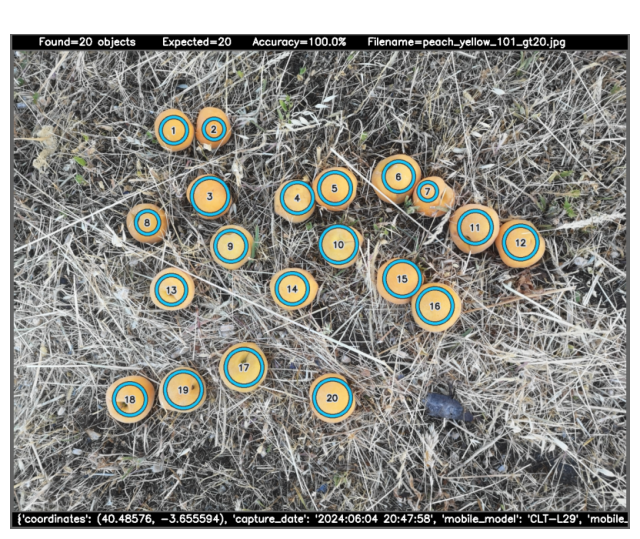

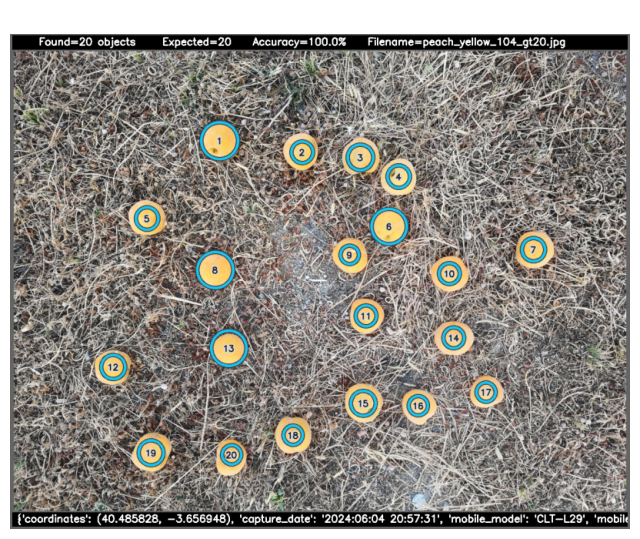

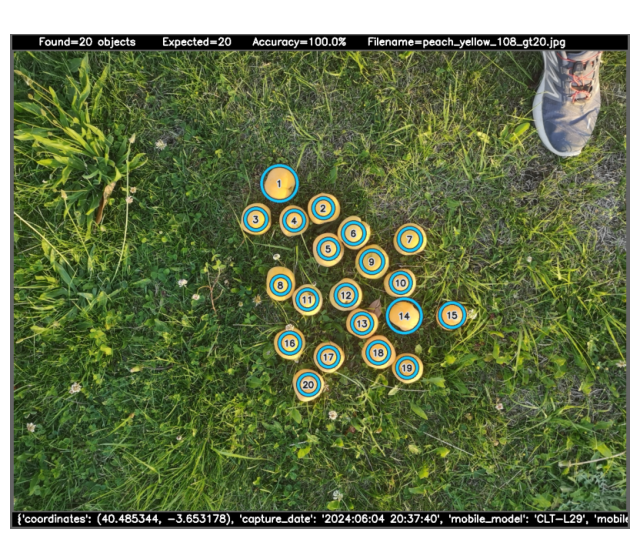

In [21]:
for result in result_images:
    utils_cv.show_mosaic([result], window_name = ' ', max_resolution=800)